# Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

# Imports

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import pickle
import math
#%matplotlib qt
%matplotlib inline

# Set

In [2]:
out_dir= 'output_images/'
input_images_dir = 'test_images/'

# Utils

In [3]:
def plot_side_by_side(img1, title1, img2, title2):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img1)
    ax1.axis('off')
    ax1.set_title(title1, fontsize=30)
    ax2.imshow(img2)
    ax2.axis('off')
    ax2.set_title(title2, fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

# Calibration and undistort

## Compute the camera calibration using chessboard images

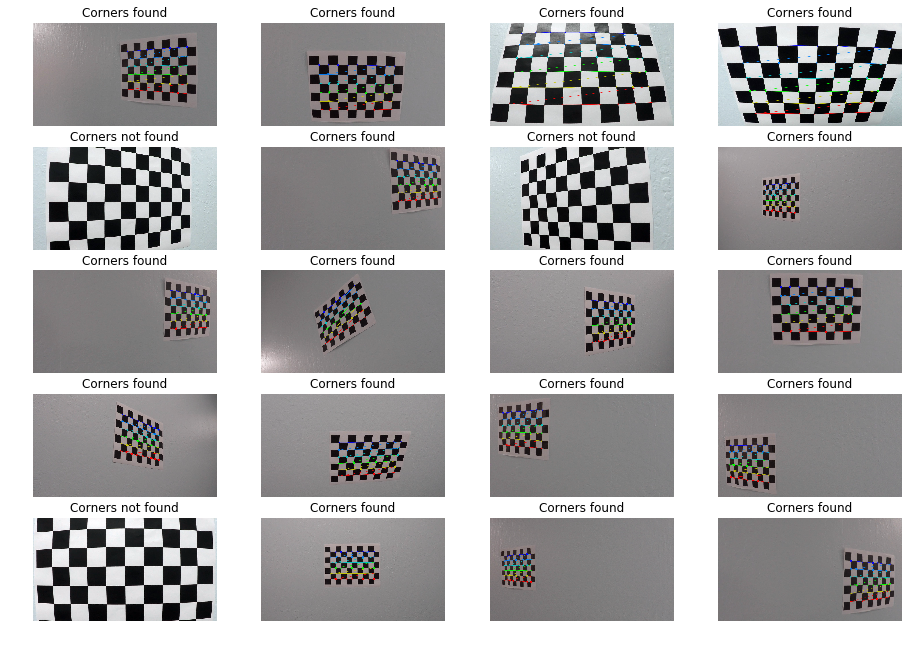

In [4]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
cal_images = glob.glob('camera_cal/calibration*.jpg')

# Print images
fig, axs = plt.subplots(math.ceil(len(cal_images)/4),4, figsize=(16, 11))
fig.subplots_adjust(hspace = .2, wspace=.1)
axs = axs.ravel()

for i in range(20):
    axs[i].axis('off')

# Step through the list and search for chessboard corners
for i, fname in enumerate(cal_images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        
        axs[i].imshow(img)
        axs[i].set_title('Corners found')
    else:
        axs[i].imshow(img)
        axs[i].set_title('Corners not found')
        
#fig.savefig(out_dir + 'calibration.png') 

## Calculate calibration matrix, undistort one chessboard sample image and save pickle file

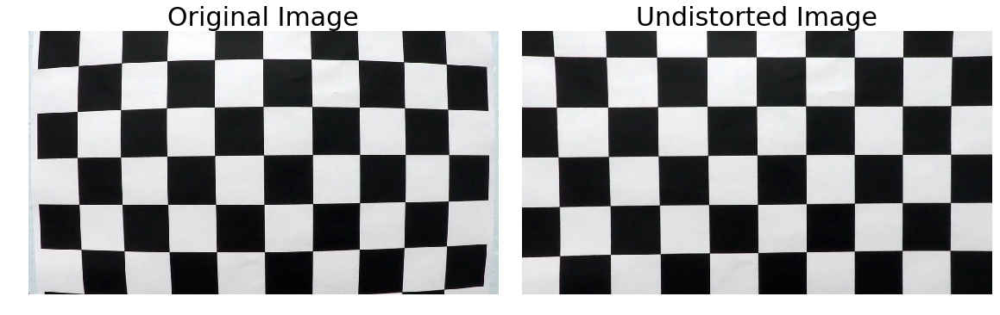

In [6]:
# Test undistortion on an image
img = cv2.imread('camera_cal/calibration1.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

# TODO : Not working/saving
# Save the camera calibration result
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump(dist_pickle, open("calibration.p", "wb"))

# Visualize undistortion
dst = cv2.undistort(img, mtx, dist, None, None)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
fig.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(img)
ax1.axis('off')
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.axis('off')
ax2.set_title('Undistorted Image', fontsize=30)

#fig.savefig(out_dir + 'undistorted.png') 

## Undistort image function

In [7]:
test_images_path = glob.glob(input_images_dir + '*.jpg')
num_test_images = len(test_images_path)
test_images = []
for img_path in test_images_path:
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    test_images.append(img)

In [8]:
def undistort(img):
    undist = cv2.undistort(img, mtx, dist, None, None)
    return undist

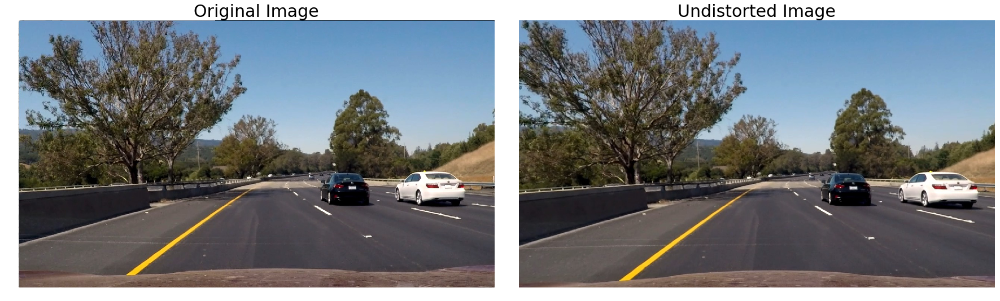

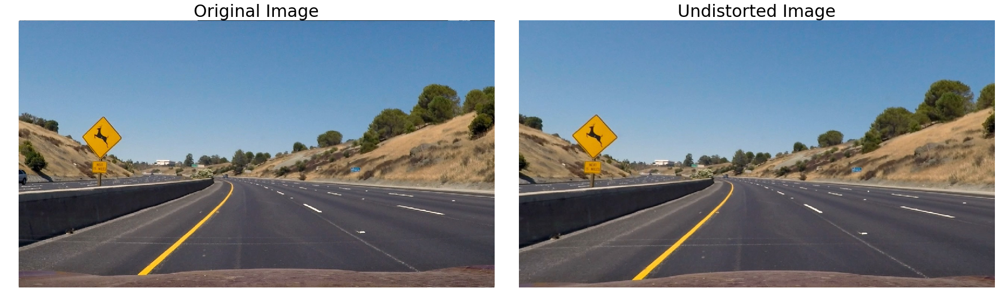

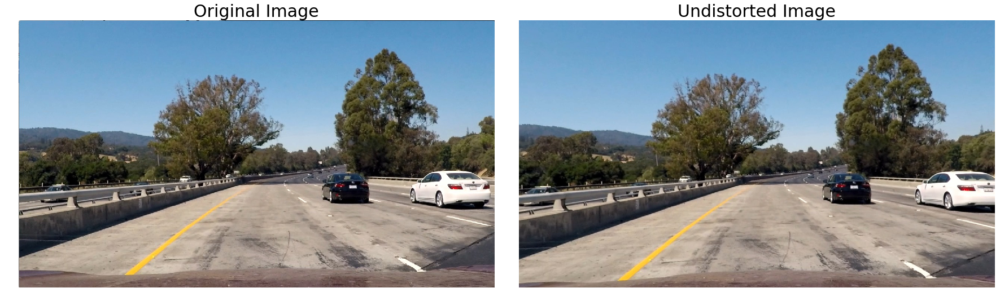

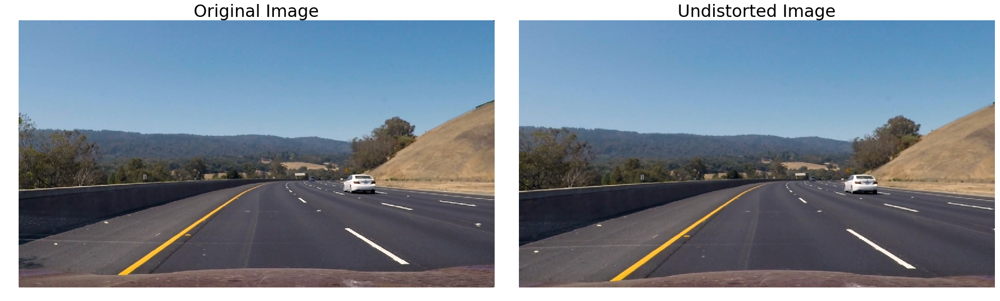

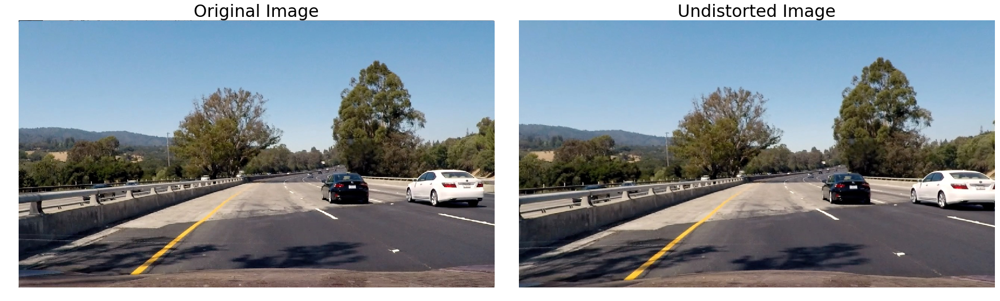

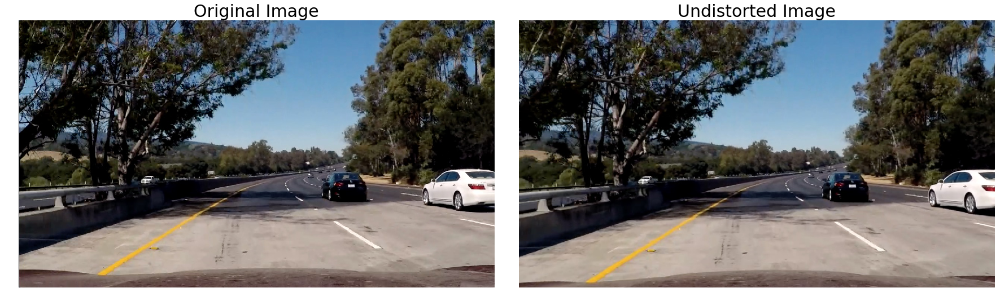

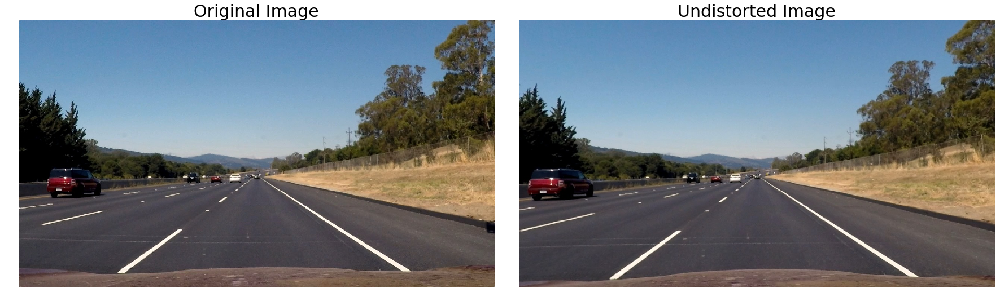

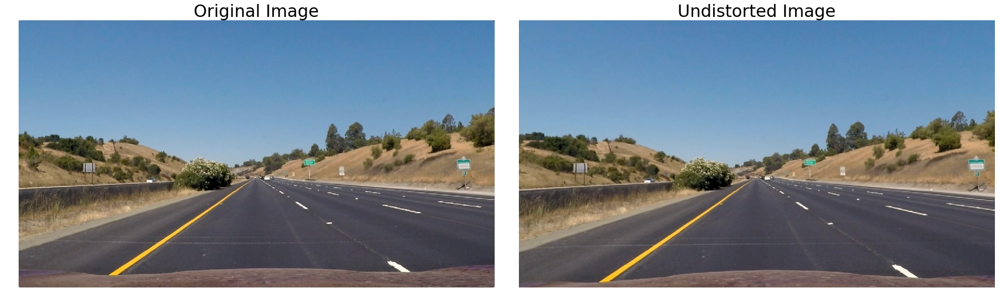

In [9]:
undist_images = []
for i, img in enumerate(test_images):
    undist_img = undistort(img)
    undist_images.append(undist_img)
    plot_side_by_side(img, 'Original Image', undist_img, 'Undistorted Image')

# Perspective Transform

In [10]:
# Class for perspective transforms
class Warper():
    def __init__(self, src, dst):
        self.M = cv2.getPerspectiveTransform(src, dst)
        self.M_inv = cv2.getPerspectiveTransform(dst, src)

    # tranform to birdeye view
    def to_birdview(self, img):
        h,w = img.shape[:2]
        return cv2.warpPerspective(img, self.M, (w, h))

    # tranform to normal view
    def to_normal(self, img):
        h,w = img.shape[:2]
        return cv2.warpPerspective(img, self.M_inv, (w, h))

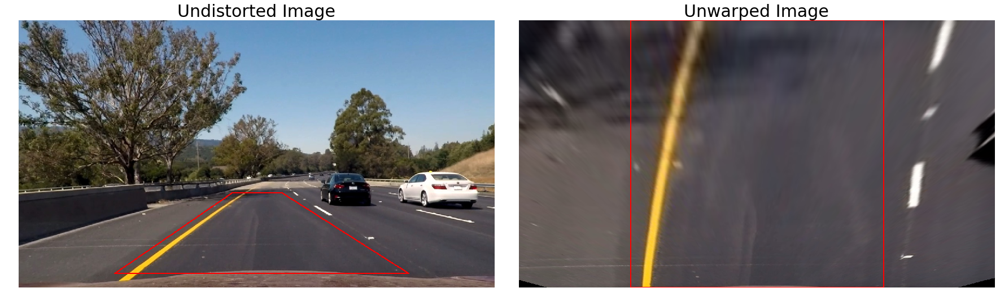

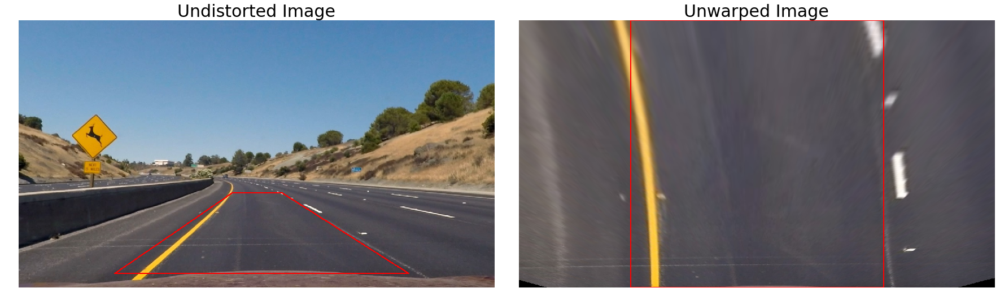

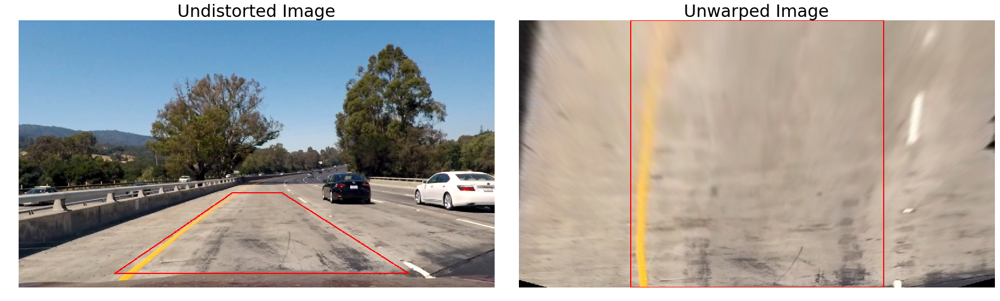

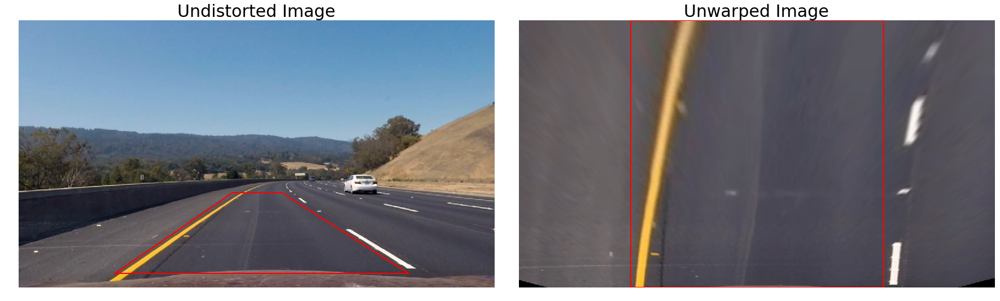

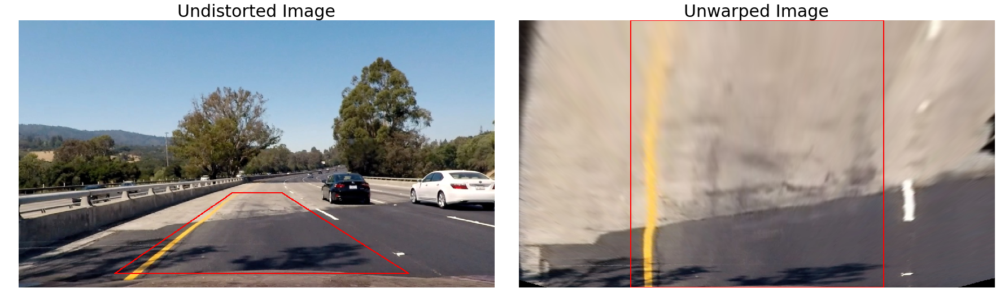

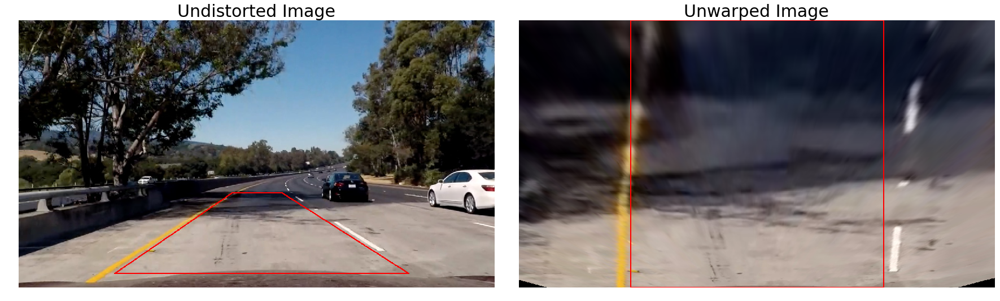

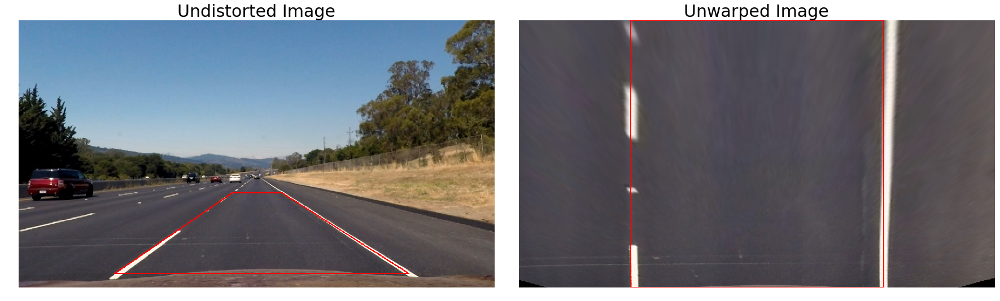

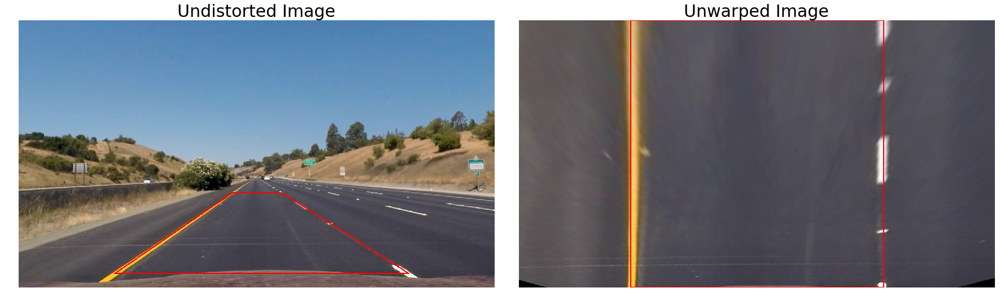

In [11]:
h,w = undist_images[0].shape[:2]

# define source and destination points for transform
src = np.float32([(575,464),
                  (707,464), 
                  (1049,682),
                  (258,682)])
offset = 300
dst = np.float32([(offset,0),
                  (w-offset,0),
                  (w-offset,h),
                  (offset,h)])

def draw_zone(img, zone):
    zone_tuples=[]
    for ind, z in enumerate(zone):
        zone_tuples.append(tuple(zone[ind]))

    cv2.line(img, zone_tuples[0], zone_tuples[1], color=[255,0,0], thickness=2)
    cv2.line(img, zone_tuples[1], zone_tuples[2], color=[255,0,0], thickness=2)
    cv2.line(img, zone_tuples[2], zone_tuples[3], color=[255,0,0], thickness=2)
    cv2.line(img, zone_tuples[3], zone_tuples[0], color=[255,0,0], thickness=2)
    return img

warper = Warper(src, dst)

unwarp_images = []
for undist_img in undist_images:
    unwarp_img = warper.to_birdview(undist_img)
    unwarp_images.append(unwarp_img)
    
    undist_img_clone = np.copy(undist_img)
    draw_zone(undist_img_clone, src)
    unwarp_img_clone = np.copy(unwarp_img)
    draw_zone(unwarp_img_clone, dst)
    plot_side_by_side(undist_img_clone, 'Undistorted Image', unwarp_img_clone, 'Unwarped Image')

# Explore colorspaces

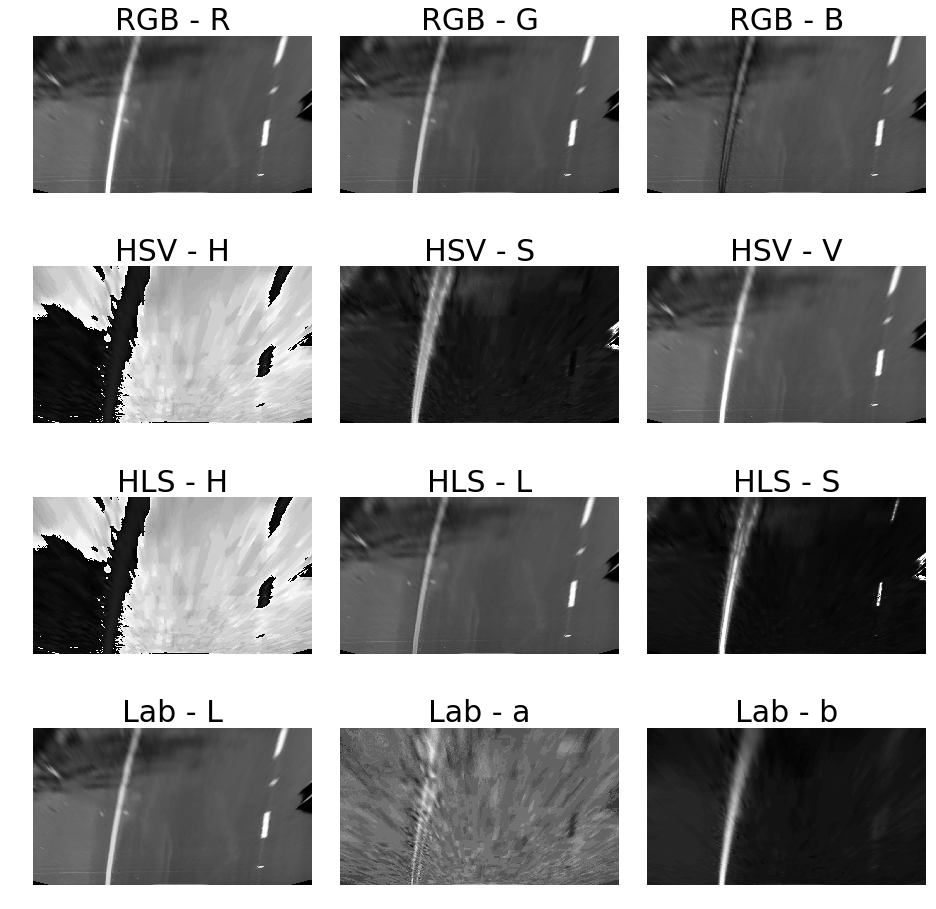

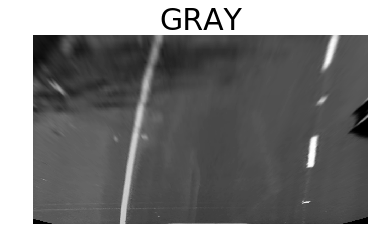

In [15]:
unwarp_RGB = unwarp_images[0]

unwarp_HSV = cv2.cvtColor(unwarp_RGB, cv2.COLOR_RGB2HSV)
unwarp_HLS = cv2.cvtColor(unwarp_RGB, cv2.COLOR_RGB2HLS)
unwarp_Lab = cv2.cvtColor(unwarp_RGB, cv2.COLOR_RGB2Lab)
unwarp_gray = cv2.cvtColor(unwarp_RGB, cv2.COLOR_RGB2GRAY)

def display_channels(axes, i, img, colorspace, channels):
    for j in range(3):
        axes[i][j].imshow(img[:,:,j], cmap='gray')
        axes[i][j].set_title(colorspace + " - " + channels[j], fontsize=30)
        axes[i][j].axis('off')

fig, axs = plt.subplots(4,3, figsize=(16, 16))
fig.subplots_adjust(hspace = .3, wspace=.1)

display_channels(axs, 0, unwarp_RGB, "RGB", ["R", "G", "B"])
display_channels(axs, 1, unwarp_HSV, "HSV", ["H", "S", "V"])
display_channels(axs, 2, unwarp_HLS, "HLS", ["H", "L", "S"])
display_channels(axs, 3, unwarp_Lab, "Lab", ["L", "a", "b"])

#fig.savefig(out_dir + 'color_exploration.png')
plt.show()
plt.imshow(unwarp_gray, cmap = 'gray')
plt.title("GRAY", fontsize=30)
plt.axis('off')
#plt.imsave(out_dir + 'gray.png', unwarp_gray, cmap = 'gray')
plt.show()

In [16]:
def binarize(img, s_thresh=(120, 255), sx_thresh=(20, 255),l_thresh=(40,255)):
    img = np.copy(img)
    
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    #h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Sobel x
    # sobelx = abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255))
    # l_channel_col=np.dstack((l_channel,l_channel, l_channel))
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold saturation channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1

    # Threshold lightness
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh[0]) & (l_channel <= l_thresh[1])] = 1
    
    channels = 255*np.dstack(( l_binary, sxbinary, s_binary)).astype('uint8')        
    binary = np.zeros_like(sxbinary)
    binary[((l_binary == 1) & (s_binary == 1) | (sxbinary==1))] = 1
    binary = 255*np.dstack((binary,binary,binary)).astype('uint8')            
    return  binary,channels

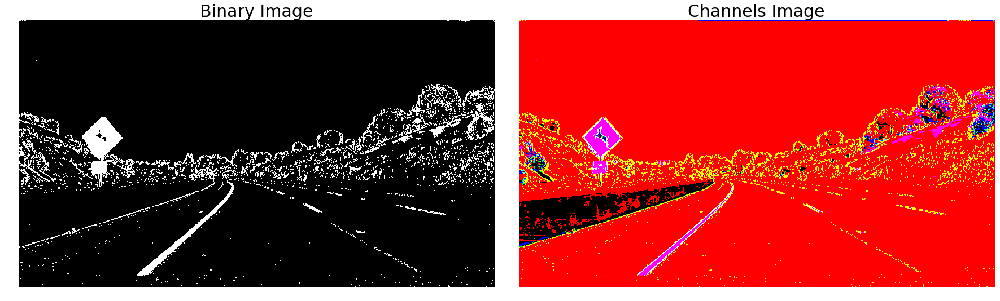

In [18]:
img = plt.imread('test_images/test2.jpg')

shape = img.shape
binary, channels = binarize(img)
#plt.imsave(out_dir + 'binary.png', binary)
#plt.imsave(out_dir + 'channels.png', channels)

plot_side_by_side(binary, 'Binary Image', channels, 'Channels Image')

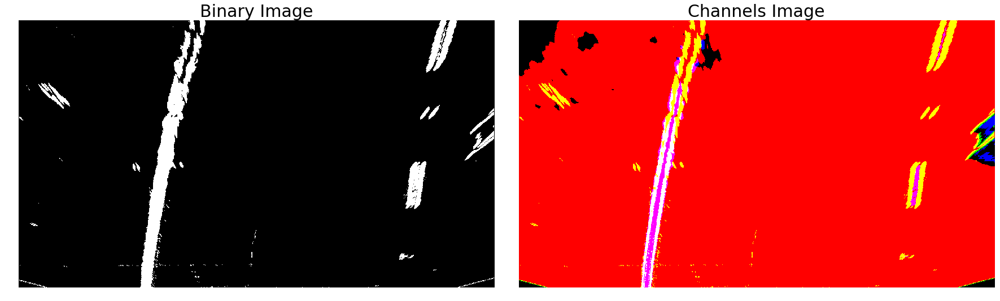

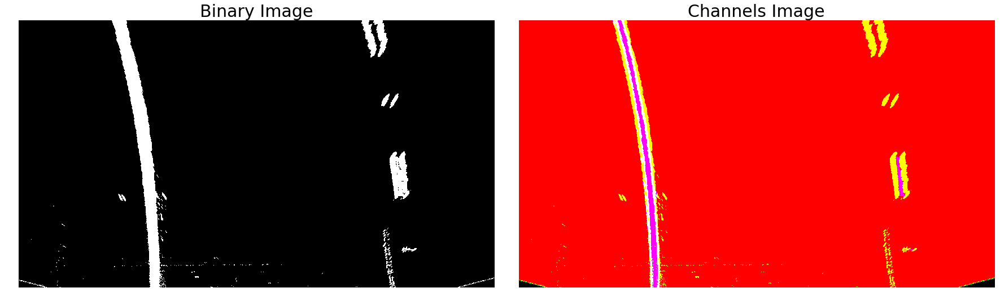

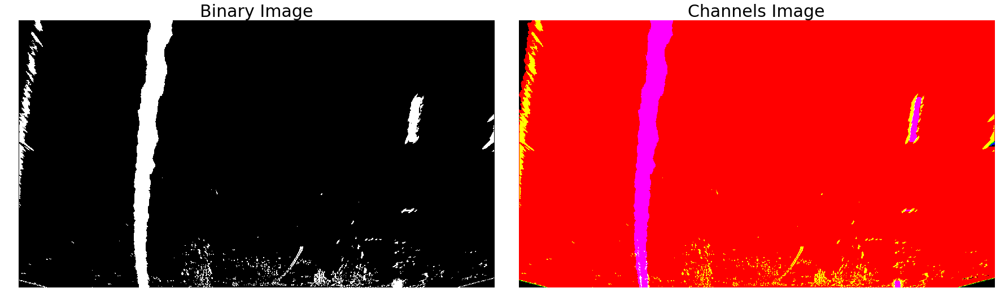

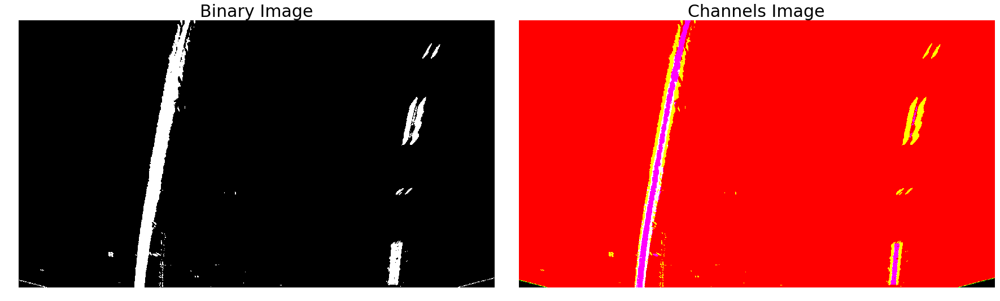

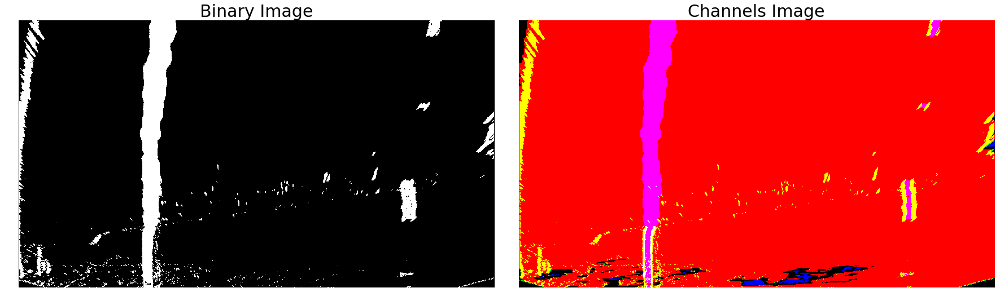

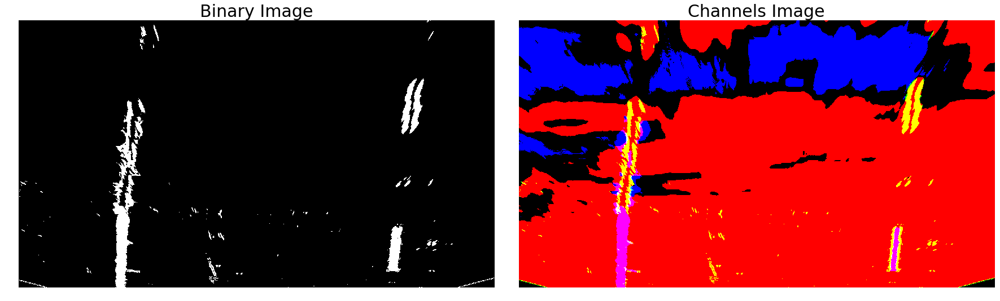

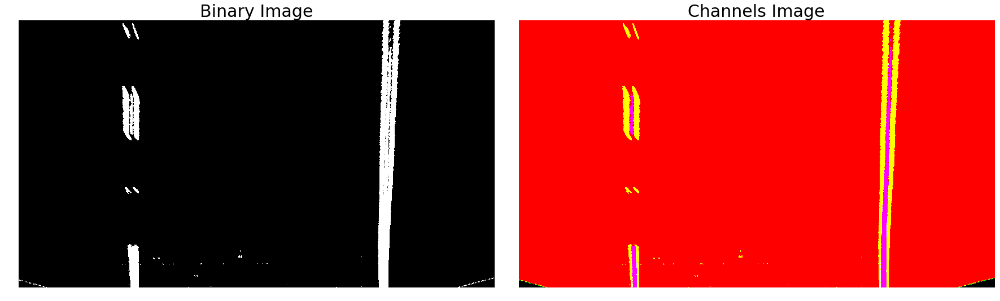

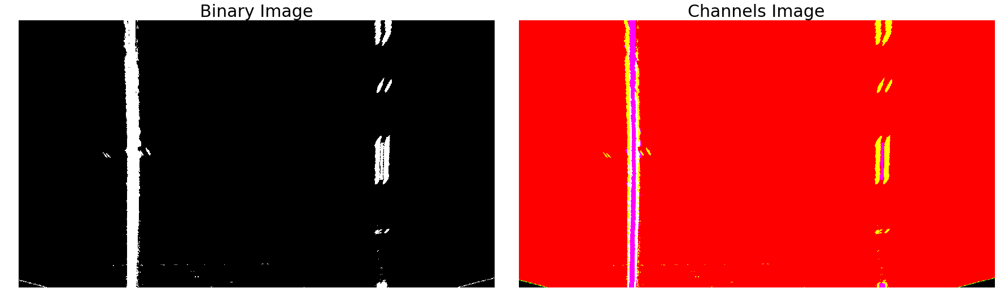

In [19]:
binarized_images = []
for unwarp_img in unwarp_images:
    bin_img, channels_img = binarize(unwarp_img)
    binarized_images.append(bin_img)
    plot_side_by_side(bin_img, 'Binary Image', channels_img, 'Channels Image')

# Finding lines

In [20]:
class Line():
    '''
    Keeps track of line.
    '''
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False

        # x values of the last n fits of the line
        self.recent_xfitted = []

        # average x values of the fitted line over the last n iterations
        self.bestx = None

        # polynomial coefficients averaged over the last n iterations
        self.best_fit = None

        # polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]

        # radius of curvature of the line in some units
        self.radius_of_curvature = None

        # distance in meters of vehicle center from the line
        self.line_base_pos = None

        # difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float')

        # x values for detected line pixels
        self.all_x = None

        # y values for detected line pixels
        self.all_y = None

In [21]:
def non_sliding(binary_warped, line):
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100

    left_fit = left_line.current_fit
    right_fit = right_line.current_fit

    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin))
        & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin))
        & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    if line == 'left':
        return leftx, lefty
    elif line == 'right':
        return rightx, righty

In [95]:
def sliding_window(binary_warped, line):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
    #plt.plot(histogram)
    #plt.show()

    # Create an output image to draw on and  visualize the result
    out_img = (np.dstack((binary_warped, binary_warped, binary_warped)) * 255).astype(np.uint8)
        
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9

    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img, (win_xleft_low,win_y_low), (win_xleft_high,win_y_high), color=(0,255,0), thickness=2) # Green
        cv2.rectangle(out_img, (win_xright_low,win_y_low), (win_xright_high,win_y_high), color=(0,255,0), thickness=2) # Green
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    '''    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.show()
    '''
    
    if line == 'left':
        return leftx, lefty
    elif line == 'right':
        return rightx, righty

In [96]:
def fit(leftx, lefty, rightx, righty):
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    return left_fit, right_fit

def calculate_radius_and_offset(ploty, leftx, lefty, rightx, righty, left_fitx, right_fitx, img_shape):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, deg=2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, deg=2)

    # Calculate radii of curvature in meters
    y_eval = np.max(ploty)  # Where radius of curvature is measured
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

    radius = np.mean([left_curverad, right_curverad])
    
    midpoint = np.int(img.shape[1]/2)
    middle_of_lane = (right_fitx[-1] - left_fitx[-1]) / 2.0 + left_fitx[-1]
    offset = (midpoint - middle_of_lane) * xm_per_pix
    
    return radius, offset

def draw_result_image(undist, binary_warped, left_fitx, right_fitx, ploty):
    # Create an image to draw the lines on
    warped_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warped = np.dstack((warped_zero, warped_zero, warped_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warped, np.int_([pts]), (0,255, 0))

    # Draw the lines on the warped image
    for i in range(len(ploty)-1):
        cv2.line(color_warped, (int(left_fitx[i]), int(ploty[i])), (int(left_fitx[i+1]), int(ploty[i+1])), (255, 0, 0), 25);
        cv2.line(color_warped, (int(right_fitx[i]), int(ploty[i])), (int(right_fitx[i+1]), int(ploty[i+1])), (0, 0, 255), 25);

    # Warp the warped image back to original image space using inverse perspective matrix (Minv)
    unwarped = warper.to_normal(color_warped)

    #print(binary_warped.shape)
    #print(undist.shape)
    #print(color_warped.shape)
    #print(unwarped.shape)

    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, unwarped, 0.5, 0)
    
    return result
    
def pipeline(img):
    undist = undistort(img)
    warped = warper.to_birdview(undist)
    binary_warped3, _ = binarize(warped)
    binary_warped = binary_warped3[:,:,0]

    # Check if line was detected in previous frame:
    if left_line.detected == True:
        leftx, lefty = non_sliding(binary_warped, 'left')
    elif left_line.detected == False:
        leftx, lefty = sliding_window(binary_warped, 'left')
        left_line.detected = True
        
    if right_line.detected == True:
        rightx, righty = non_sliding(binary_warped, 'right')
    elif right_line.detected == False:
        rightx, righty = sliding_window(binary_warped, 'right')
        right_line.detected = True

    left_fit, right_fit = fit(leftx, lefty, rightx, righty)
    
    # Stash away polynomials
    left_line.current_fit = left_fit
    right_line.current_fit = right_fit
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    img_shape = binary_warped.shape
    radius, offset = calculate_radius_and_offset(ploty, leftx, lefty, rightx, righty, left_fitx, right_fitx, img_shape)

    result = draw_result_image(undist, binary_warped, left_fitx, right_fitx, ploty)

    # Add radius and offset calculations to top of video
    cv2.putText(result,"Curvature Radius: " + "{:0.2f}".format(radius) + ' m', org=(50,75), fontFace=cv2.FONT_HERSHEY_SIMPLEX,
            fontScale=2, color=(0,0,0), lineType = cv2.LINE_AA, thickness=2)
    cv2.putText(result,"Lane center offset: " + "{:0.2f}".format(offset) + ' m', org=(50,125), fontFace=cv2.FONT_HERSHEY_SIMPLEX,
            fontScale=2, color=(0,0,0), lineType = cv2.LINE_AA, thickness=2)

    return result
    #plt.imshow(result)
    #plt.show()

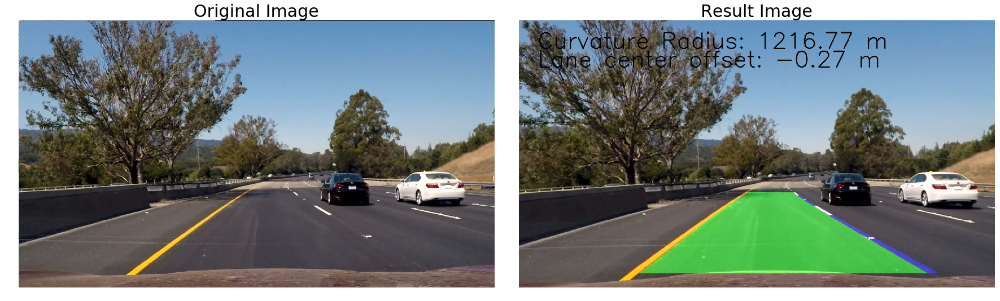

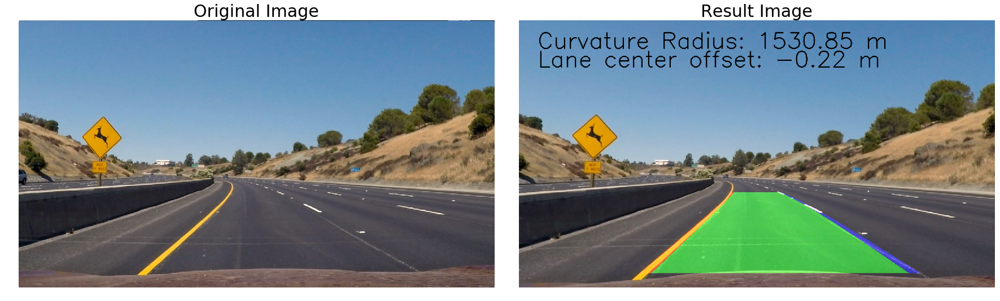

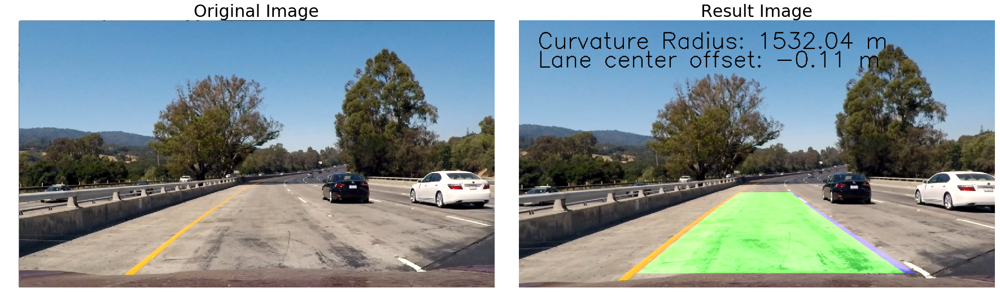

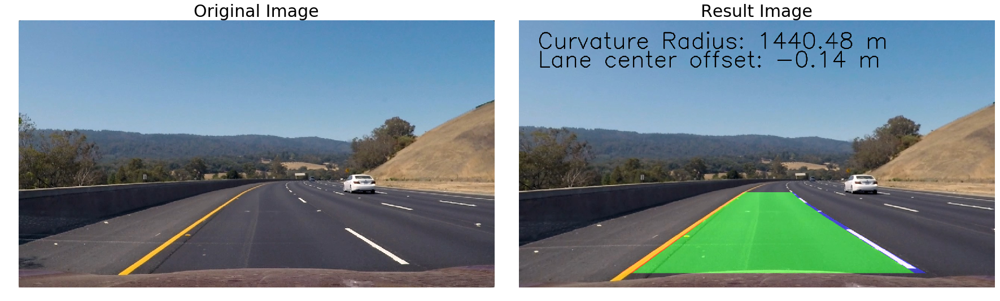

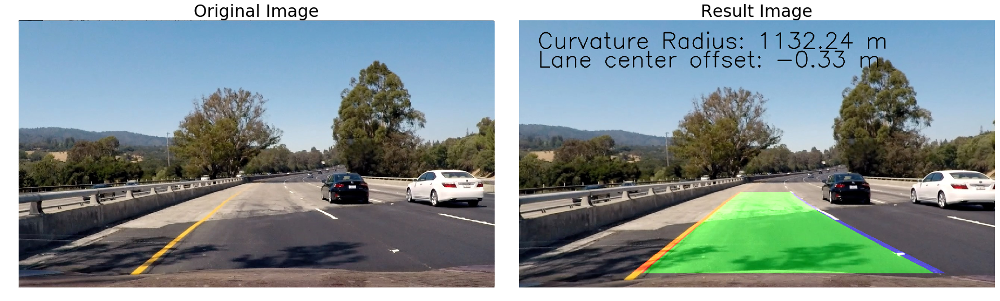

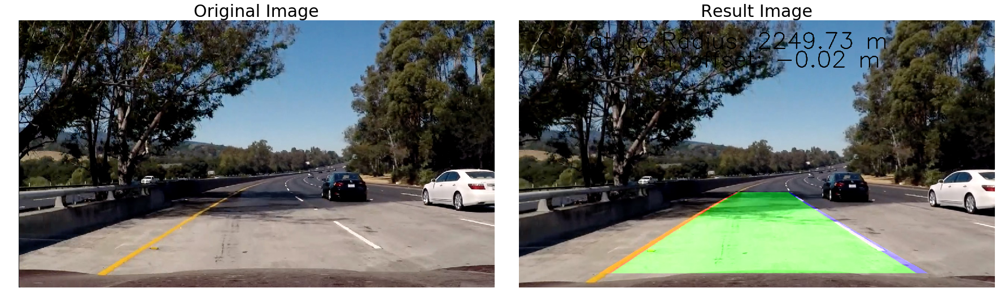

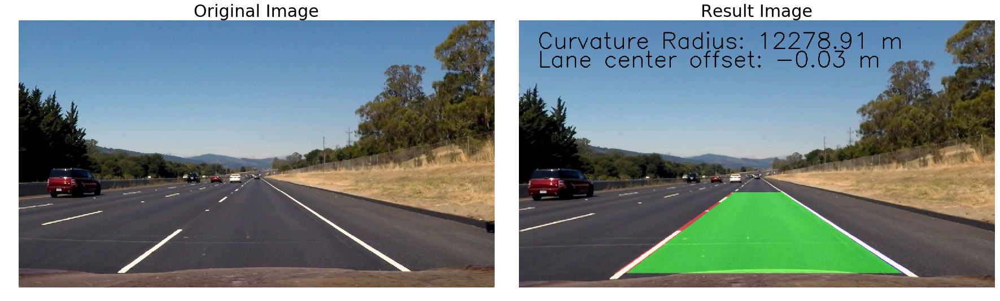

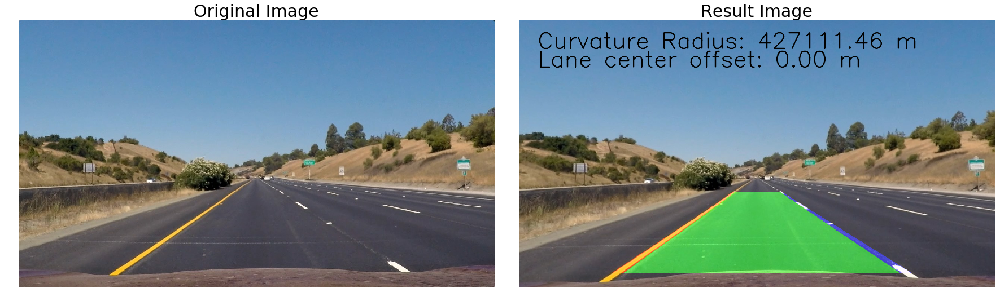

In [97]:
warper = Warper(src, dst)

left_line = Line()
right_line = Line()

test_images_path = glob.glob(input_images_dir + '*.jpg')
num_test_images = len(test_images_path)
test_images = []
for img_path in test_images_path:
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    test_images.append(img)

for i, img in enumerate(test_images):
    result = pipeline(img)
    plot_side_by_side(img, 'Original Image', result, 'Result Image')

In [99]:
from moviepy.editor import VideoFileClip

left_line = Line()
right_line = Line()

movie_output = 'final_output.mp4'
clip1 = VideoFileClip("project_video.mp4", fps_source = 'fps')
driving_clip = clip1.fl_image(pipeline)
%time driving_clip.write_videofile(movie_output, audio=False)

[MoviePy] >>>> Building video final_output.mp4
[MoviePy] Writing video final_output.mp4


100%|█████████▉| 1260/1261 [05:35<00:00,  3.87it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: final_output.mp4 

CPU times: user 9min 37s, sys: 2min 44s, total: 12min 22s
Wall time: 5min 35s
